## 1. Import libraries

In [26]:
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn.ensemble import IsolationForest
from sklearn.linear_model import LinearRegression
pd.set_option('display.max_columns', None)
from scipy.stats import chi2_contingency
import eda_helper_functions

import plotly.express as px
import geopandas as gpd 
import json
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff



import os

## 2. Read the Training Data

In [2]:
def get_data(name, base_dir=None):
    # If base_dir is not provided, use the current working directory
    if base_dir is None:
        base_dir = os.getcwd()
    
    # Construct the path to the Data directory
    data_dir = os.path.join(base_dir, '..', 'Data')
    
    # Construct the full file path
    file_name = f"{name}.csv"
    file_path = os.path.join(data_dir, file_name)
    
    # Check if the file exists
    if not os.path.exists(file_path):
        raise FileNotFoundError(f"The file {file_name} does not exist in the specified path.")
    
    # Read and return the CSV file
    return pd.read_csv(file_path)

In [3]:
train = get_data('cleaned_data')
train.shape

(199588, 30)

In [4]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199588 entries, 0 to 199587
Data columns (total 30 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   serviceCharge             199588 non-null  float64
 1   picturecount              199588 non-null  int64  
 2   pricetrend                199588 non-null  float64
 3   telekomUploadSpeed        199588 non-null  float64
 4   totalRent                 199588 non-null  float64
 5   baseRent                  199588 non-null  float64
 6   livingSpace               199588 non-null  float64
 7   noRooms                   199588 non-null  int64  
 8   residents                 199588 non-null  int64  
 9   zip_area_sq_km            199588 non-null  float64
 10  stateName                 199588 non-null  object 
 11  heatingType               199588 non-null  object 
 12  telekomTvOffer            199588 non-null  object 
 13  newlyConst                199588 non-null  b

In [5]:
# change datatype 
columns_to_convert = [
    'telekomUploadSpeed',
    'noRooms',
    'geo_plz',
    'picturecount',
    'cityCode'
]

for column in columns_to_convert:
    train[column] = train[column].astype('int').astype('object')


In [6]:
print(f'No of categorical columns: {train.select_dtypes(include='object').shape[1]}')
print(f'No of numerical columns: {train.select_dtypes(include='number').shape[1]}')
print(f'No of bool columns: {train.select_dtypes(include='bool').shape[1]}')

No of categorical columns: 17
No of numerical columns: 7
No of bool columns: 6


## 3. High level summary of data

In [7]:
train.describe(include='number').T

,count,mean,std,min,25%,50%,75%,max
serviceCharge,199588.0,152.590228,343.939534,0.000000,98.000000,135.020000,190.000000,146118.000000
pricetrend,199588.0,3.419315,1.960124,-12.330000,2.040000,3.390000,4.570000,14.920000
totalRent,199588.0,800.499749,522.554150,0.000000,499.000000,655.000000,920.000000,13500.000000
baseRent,199588.0,655.579430,505.073055,0.000000,339.000000,495.000000,807.840000,11000.000000
livingSpace,199588.0,73.746695,31.383394,1.000000,55.000000,67.705000,87.000000,542.530000
residents,199588.0,19811.194676,8969.183878,0.000000,14076.000000,19120.000000,24400.000000,58782.000000
zip_area_sq_km,199588.0,36.605663,62.889090,0.001829,5.097179,14.536409,45.119036,891.943577


In [8]:
train.describe(include=['object']).T

,count,unique,top,freq
picturecount,199588,92,8,16383
telekomUploadSpeed,199588,6,40,142961
noRooms,199588,14,3,77521
stateName,199588,16,Nordrhein_Westfalen,48941
heatingType,199588,13,central_heating,114272
telekomTvOffer,199588,3,ONE_YEAR_FREE,168894
firingTypes,199588,128,gas,102316
condition,199588,11,well_kept,52291
interiorQual,199588,5,unknown,81356
petsAllowed,199588,4,unknown,84319


In [9]:
train.describe(include=['bool']).T

,count,unique,top,freq
newlyConst,199588,2,False,179270
balcony,199588,2,True,129540
hasKitchen,199588,2,False,133425
cellar,199588,2,True,132640
lift,199588,2,False,148093
garden,199588,2,False,161677


### 4. PairPlots

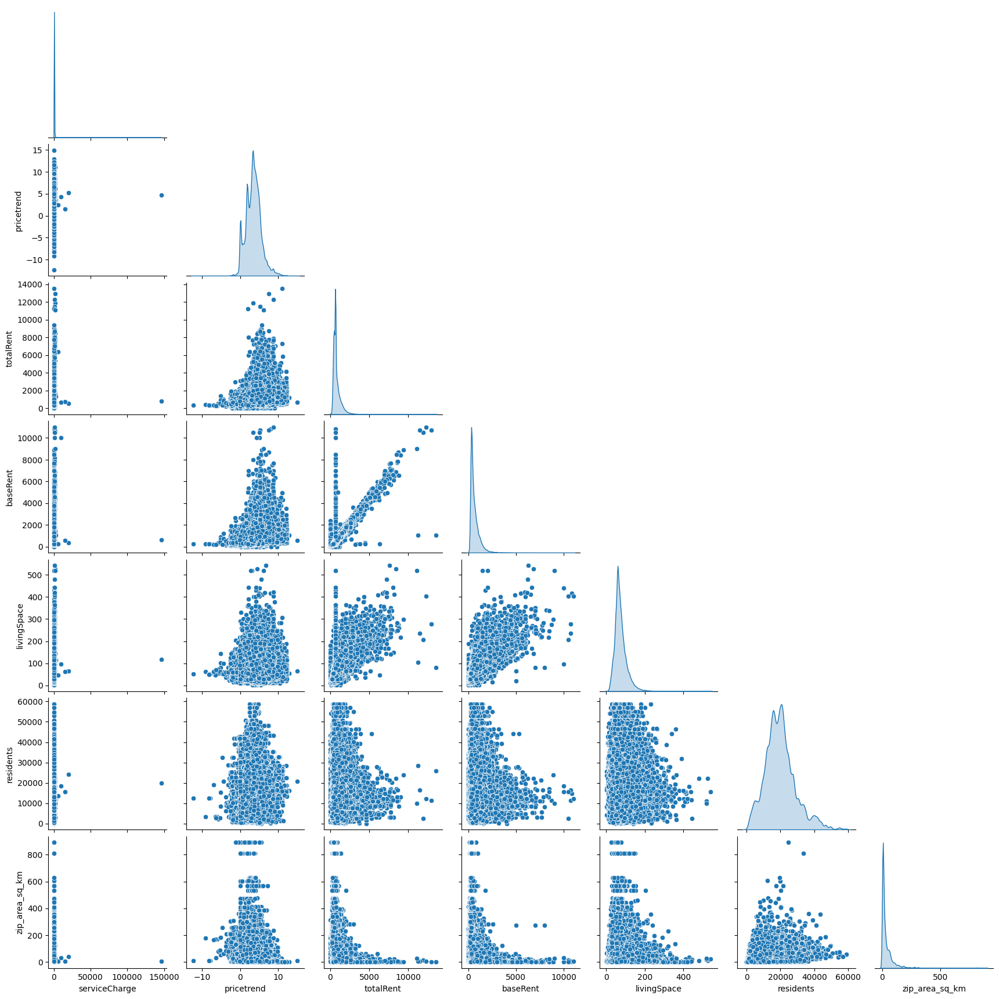

In [10]:
sns.pairplot(train.select_dtypes(include='number'), diag_kind='kde', corner=True)

## 5. Correlation Analysis

In [11]:
corr_matrix = train.select_dtypes(include='number').corr()
corr_matrix

,serviceCharge,pricetrend,totalRent,baseRent,livingSpace,residents,zip_area_sq_km
serviceCharge,1.000000,0.060162,0.166362,0.168943,0.176451,-0.007888,-0.030680
pricetrend,0.060162,1.000000,0.406115,0.438724,0.184425,-0.013591,-0.174801
totalRent,0.166362,0.406115,1.000000,0.890594,0.674517,-0.052907,-0.153219
baseRent,0.168943,0.438724,0.890594,1.000000,0.731376,-0.061419,-0.163377
livingSpace,0.176451,0.184425,0.674517,0.731376,1.000000,-0.040749,-0.042776
residents,-0.007888,-0.013591,-0.052907,-0.061419,-0.040749,1.000000,0.176261
zip_area_sq_km,-0.030680,-0.174801,-0.153219,-0.163377,-0.042776,0.176261,1.000000


In [12]:
annotations = [
    dict(
        x=x,
        y=y,
        text=f"{corr_matrix.iloc[y, x]:.2f}",
        showarrow=False,
        font=dict(size=10, color="white"),
        align="center"
    )
    for y in range(len(corr_matrix.columns))
    for x in range(len(corr_matrix.columns))
]

# Create the heatmap figure
fig = go.Figure(
    data=go.Heatmap(
        z=corr_matrix.values,
        x=corr_matrix.columns.tolist(),
        y=corr_matrix.columns.tolist(),
        colorscale="Viridis_r",
        zmin=-1,  
        zmax=1,
        colorbar=dict(title="Correlation"),
        hoverongaps=False  
    )
)

# Add annotations to the heatmap
fig.update_layout(
    title="Full Correlation Heatmap",
    xaxis=dict(tickangle=45, title="Features"),
    yaxis=dict(title="Features", autorange="reversed"),
    height=600,
    width=800,
    annotations=annotations  #
)

# Show the heatmap
fig.show()

In [ ]:
# Function to calculate Cramer's V
def cramers_v(x, y):
    contingency_table = pd.crosstab(x, y)
    chi2 = chi2_contingency(contingency_table)[0]
    n = contingency_table.sum().sum()
    phi2 = chi2 / n
    r, k = contingency_table.shape
    phi2corr = max(0, phi2 - ((k - 1)*(r - 1))/(n - 1))
    rcorr = r - ((r - 1)**2)/(n - 1)
    kcorr = k - ((k - 1)**2)/(n - 1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

# Select categorical columns
categorical_cols = train.select_dtypes(include=['object', 'bool']).drop(columns=['lat','lon'], axis = 1)

# Calculate Cramer's V for each pair of categorical columns
cramers_v_matrix = pd.DataFrame(index=categorical_cols, columns=categorical_cols)

categorical_cols = train.select_dtypes(include=['object', 'bool']).columns

# Calculate Cramer's V for each pair of categorical columns
for col1 in categorical_cols:
    for col2 in categorical_cols:
        cramers_v_matrix.loc[col1, col2] = cramers_v(train[col1], train[col2])

# Convert to float for heatmap
cramers_v_matrix = cramers_v_matrix.astype(float)

In [ ]:
# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cramers_v_matrix, annot=True, cmap='coolwarm', vmin=0, vmax=1, cbar=False,fmt=".1f", linewidths=.5)
plt.title("Cramer's V Heatmap")
plt.show()

## 6. Detailed Analysis

In [13]:
eda_helper_functions.cat_summary(train, "stateName")

0         Nordrhein_Westfalen
1                     Sachsen
2                     Sachsen
3                      Bremen
4          Schleswig_Holstein
                 ...         
199583                 Bayern
199584                 Hessen
199585                 Hessen
199586    Nordrhein_Westfalen
199587                 Hessen
Name: stateName, Length: 199588, dtype: object

Data Type      : object
Cardinality    : 16 categories
Missing Data   : 0 rows (0.00 %)
Available Data : 199,588 / 199,588 rows


,
count,199588
unique,16
top,Nordrhein_Westfalen
freq,48941


,count,percentage
category,,
Nordrhein_Westfalen,48941,0.245210
Sachsen,40402,0.202427
Bayern,16132,0.080827
Sachsen_Anhalt,14826,0.074283
Hessen,12905,0.064658
Niedersachsen,12527,0.062764
Baden_Württemberg,11273,0.056481
Berlin,8621,0.043194
Thüringen,6071,0.030418


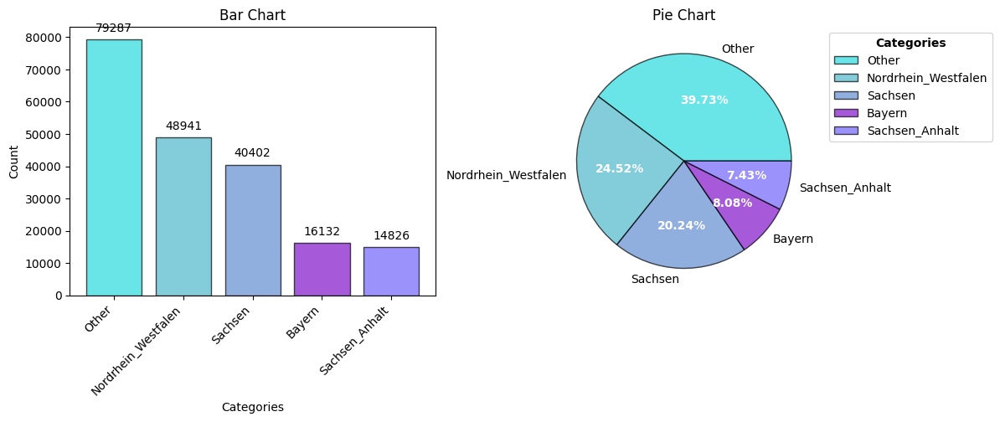

In [14]:
eda_helper_functions.cat_univar_plots(train, "stateName", show_wordcloud= False, k=4)  #top 4 categories

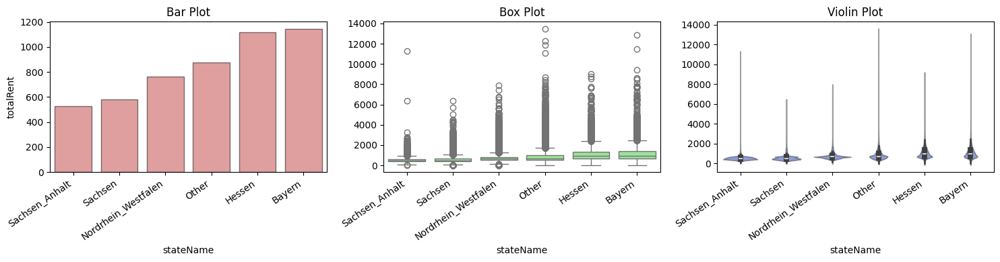

In [15]:
eda_helper_functions.num_cat_bivar_plots(
    data = train,
    num_var= "totalRent",
    cat_var= "stateName",
    k=5
)

In [16]:
eda_helper_functions.num_cat_hyp_testing(train, "totalRent","stateName")

- Significance Level   : 5.0%
- Null Hypothesis      : The groups have similar population mean
- Alternate Hypothesis : The groups don't have similar population mean
- Test Statistic       : 3471.54568750673
- p-value              : 0.0
- Since p-value is less than 0.05, we Reject the Null Hypothesis at 5.0% significance level
- CONCLUSION: The variables totalRent and stateName are associated to each other


- Significance Level   : 5.0%
- Null Hypothesis      : The groups have similar population median
- Alternate Hypothesis : The groups don't have similar population median
- Test Statistic       : 59504.125853842685
- p-value              : 0.0
- Since p-value is less than 0.05, we Reject the Null Hypothesis at 5.0% significance level
- CONCLUSION: The variables totalRent and stateName are associated to each other


noRooms         object
livingSpace    float64
dtype: object


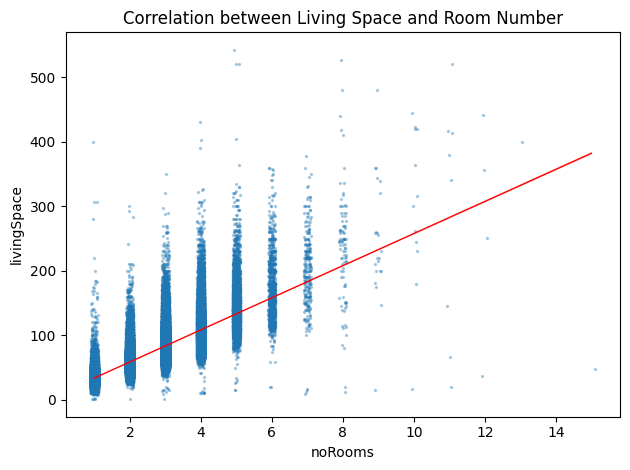

In [17]:
print(train[['noRooms', 'livingSpace']].dtypes)
train['noRooms'] = pd.to_numeric(train['noRooms'], errors='coerce')
train['livingSpace'] = pd.to_numeric(train['livingSpace'], errors='coerce')


sns.regplot(data=train, x='noRooms', y='livingSpace',x_jitter = 0.1,line_kws=dict(lw=1,color="r"),scatter_kws=dict(alpha=0.3, s=2))
plt.title('Correlation between Living Space and Room Number')
plt.tight_layout();

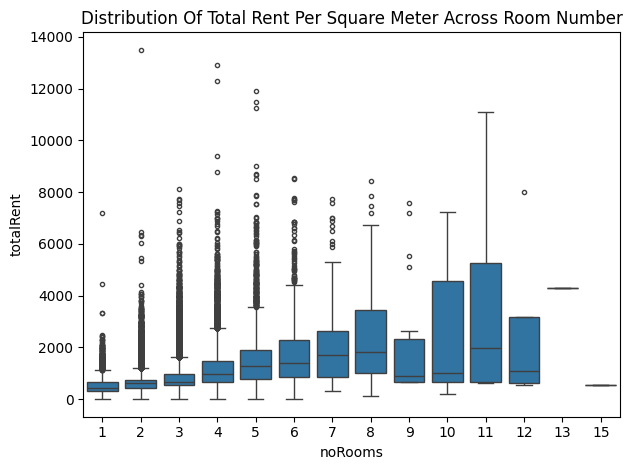

In [20]:
sns.boxplot(data=train, x='noRooms', y='totalRent',fliersize=3)
plt.title('Distribution Of Total Rent Per Square Meter Across Room Number')
plt.tight_layout()

In [22]:
# export csv file
def export_dataframe(dataframe, file_name):
    # defining base dir
    base_dir = os.getcwd()
    
    # Construct the path to the Data directory
    data_dir = os.path.join(base_dir, '..', 'Data')

    # Ensure the directory exists
    os.makedirs(data_dir, exist_ok=True)
    
    # Create the full file path
    file_path = os.path.join(data_dir, file_name)
    
    # Export the dataframe to CSV
    dataframe.to_csv(file_path, index=False)
    
    print(f"DataFrame exported to: {file_path}")

export_dataframe(train, 'eda_data.csv')

DataFrame exported to: /Users/sudhirjoon/Library/Mobile Documents/com~apple~CloudDocs/Uni_Mannheim/Sem2/data_visualisation/Joon_project/Notebooks/../Data/eda_data.csv


## Plotly dashboard plots 

In [23]:
# totalprice vs stateName
avg_rent_by_state = train.groupby('stateName')['totalRent'].mean().sort_values(ascending= False).reset_index()

# Create the box plot
fig = px.bar(avg_rent_by_state, x='stateName', y='totalRent', width = 1000 ,height= 500)
fig.update_layout(title='Average Total Rent per Month by State',
                   xaxis_title='State Name',
                   yaxis_title='Average Total Rent')

# customize text appearance
fig.update_traces(texttemplate='€%{y:.2f}', textposition='outside')
fig.show()

In [24]:
avg_rent_by_state = (train
                     .groupby(['stateName','date'])['totalRent']
                     .mean()
                     .reset_index()
                    ).sort_values(['date'], ascending=False)

# Create the box plot
fig = px.line(avg_rent_by_state, x='date', y='totalRent', color = 'stateName',width = 1000 ,height= 500)
fig.update_layout(title='Average Total Rent per Month by State',
                   xaxis_title='Date',
                    yaxis_title='Average Total Monthly Rent (€)',
                    legend_title='State Name')
fig.show()

In [24]:
avg_rent_by_city = train.groupby('cityName')['totalRent'].mean().sort_values(ascending=False).head(10).reset_index()

# Create the bar plot
fig = px.bar(avg_rent_by_city, x='cityName', y='totalRent', width = 1000 ,height= 500)
fig.update_layout(title='Average Total Rent per Month by Top 10 Cities',
                   xaxis_title='City Name',
                   yaxis_title='Average Total Monthly Rent ')

# customize text appearance
fig.update_traces(texttemplate='€%{y:.2f}', textposition='outside')
fig.show()


In [27]:

temp_df = train[['serviceCharge', 'date']].sort_values('date', ascending=False)
temp_df = temp_df[temp_df['serviceCharge'] <= 6000]

# Check if 'date' column exists and convert it to ordinal for regression
temp_df['date_ordinal'] = pd.to_datetime(temp_df['date']).map(pd.Timestamp.toordinal)

# Fit linear regression model
X = temp_df['date_ordinal'].values.reshape(-1, 1)
y = temp_df['serviceCharge'].values
model = LinearRegression()
model.fit(X, y)

# Get the slope and intercept
slope = model.coef_[0]
intercept = model.intercept_

# Create the box plot using Plotly
fig = px.box(temp_df, x='date', y='serviceCharge', width=600, height=400)

# Predict values for the trend line
predicted_service_charge = model.predict(X)

# Add trend line to the figure
fig.add_trace(go.Scatter(x=temp_df['date'], y=predicted_service_charge, mode='lines',
                         name='Trend Line', line=dict(color='red')))

# Add annotation for the trend line equation
equation_text = f"Trendline: y = {slope:.2f}x + {intercept:.2f}"
fig.add_annotation(
    x=temp_df['date'].iloc[-1],  # Position at the last date
    y=predicted_service_charge[-1],  # Position at the last predicted value
    text=equation_text,
    showarrow=True,
    arrowhead=2,
    ax=0,
    ay=-40,
    font=dict(size=12),
    bgcolor="white",
)

# Update layout and appearance
fig.update_layout(
    title='Average Service Charge per Year with Trend Line',
    xaxis_title='Date',
    yaxis_title='Avg Service Charge (€)'
)

# Customize y-axis appearance
fig.update_yaxes(tickprefix='€')

# Show the figure
fig.show()

In [28]:

# Create the box plot
fig = px.box(train, x='noRooms', y='totalRent', width=1000, height=500)

# Update layout
fig.update_layout(
    title='Total Rent Distribution by Number of Rooms',
    xaxis_title='Number of Rooms',
    yaxis_title='Total Rent (€)',
)

# Customize outlier appearance (similar to fliersize in Seaborn)
fig.update_traces(marker=dict(size=2))  # Adjust the size of outlier points

# Show the figure
fig.show()

## Choroplateh state graph

In [29]:

# Calculate average price per state
temp_df = train.groupby('stateName')['totalRent'].mean().reset_index()
temp_df['stateName'] = temp_df['stateName'].str.replace('_', '-')

# Load GeoJSON file for German states
with open('../GeoJSON/germany-states2.geojson') as f:
    geojson_data = json.load(f)  # Parse the string into a dictionary

# Verify if all state names match the GeoJSON
geojson_states = [feature['properties']['name'] for feature in geojson_data['features']]
missing_states = set(temp_df['stateName']) - set(geojson_states)

if missing_states:
    print(f"Missing states in GeoJSON: {missing_states}")
else:
    print("All states match the GeoJSON.")


# Create the choropleth map
fig = px.choropleth(
    temp_df,
    geojson=geojson_data,
    locations='stateName',          # Column in your DataFrame with state names
    featureidkey='properties.name', # Correct featureidkey
    color='totalRent',              # Column with average total rent
    # hover_name='stateName',         # Hover text
    color_continuous_scale= 'Viridis_r',  # Color scale
)

# Update layout for better appearance
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title='Average Total Rent per State in Germany',
    coloraxis_colorbar=dict(title='Average Rent (€)'),
    margin={"r":0,"t":50,"l":0,"b":0}  # Optional: Adjust margins
)

# Show the figure
fig.show()

All states match the GeoJSON.


## chorpleth city

In [30]:

# Load GeoJSON file for 2-digit postal codes
geojson_path = '../GeoJSON/plz-2stellig.geojson'
with open(geojson_path, 'r') as f:
    geojson_data = json.load(f)

# Extract postal codes from the GeoJSON
geojson_plz = [str(feature['properties']['plz']) for feature in geojson_data['features']]

# Ensure cityCode in train is formatted as strings with leading zeros if needed
train['cityCode'] = train['cityCode'].astype(str).str.zfill(2)

# Check for missing postal codes
missing_plz = set(train['cityCode']) - set(geojson_plz)
if missing_plz:
    print(f"Missing PLZ in GeoJSON: {missing_plz}")
else:
    print("All postal codes match the GeoJSON.")

# Validate totalRent column
if train['totalRent'].isna().any():
    print("Warning: 'totalRent' contains NaN values.")
train['totalRent'] = pd.to_numeric(train['totalRent'], errors='coerce')

# Create the choropleth map
fig = px.choropleth(
    train,
    geojson=geojson_data,
    locations='cityCode',           
    featureidkey='properties.plz',  
    color='totalRent',              
    hover_name='cityName',          
    hover_data={'totalRent': ':.2f'}, 
    color_continuous_scale='Viridis_r',  
    labels={'totalRent': 'Average Rent (€)'}  

# Update layout for better appearance
fig.update_geos(
    fitbounds="locations",
    visible=False
)

fig.update_layout(
    title={
        'text': 'Average Total Rent per 2-Digit Postal Code in Germany',
        'y': 0.95,
        'x': 0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    coloraxis_colorbar=dict(
        title='Average Rent (€)',
        title_side='right'
    ),
    margin={"r": 0, "t": 50, "l": 0, "b": 0},
    paper_bgcolor='white',
    plot_bgcolor='white'
)

# Enable hover interactivity
fig.update_layout(
    hovermode='closest',  
    dragmode=False        
)

# Display the figure
fig.show()

SyntaxError: '(' was never closed (1777033195.py, line 25)